## 한국 연예인 리스트 크롤링

### 위키백과에서 연예인 리스트 가져오기
* 배우 :: https://ko.wikipedia.org/wiki/분류:대한민국의_배우
* 아이돌 :: https://ko.wikipedia.org/wiki/분류:대한민국의_아이돌
* 가수 :: https://ko.wikipedia.org/wiki/분류:대한민국의_가수


### 위키백과 페이징
* 배우 ::  https://ko.wikipedia.org/w/index.php?title=분류:대한민국의_배우&pagefrom=
* 아이돌 ::  https://ko.wikipedia.org/w/index.php?title=분류:대한민국의_아이돌&pagefrom=
* 가수 ::  https://ko.wikipedia.org/w/index.php?title=분류:대한민국의_가수&pagefrom=

* 유명하지 않은 사람도 많기때문에 유명한 사람만 가져올 방법? 
* 위키백과에 사진이 올라와 있는 사람만 가져오기
* 링크 :: https://ko.wikipedia.org/api/rest_v1/page/summary/김태희


* pip install beautifulsoup4
* pip install requests

In [ ]:
from bs4 import BeautifulSoup
import requests
import json
import time

def addResultList(nameList,startIdx,resultList): 
    for idx,name in enumerate(nameList):
        time.sleep(0.2)
        if idx<startIdx :
            continue
        nameTxt = name.text
        
        res = requests.get(url2+nameTxt,headers=headers)
        html = res.text
        soup = BeautifulSoup(html,'html.parser')
        detail_json = json.loads(soup.text)
        
        global lastName
        lastName = nameTxt
        #print('마지막이름 >> ',lastName)
        if not detail_json.get("thumbnail") == None:
            print(nameTxt)
            #print(detail_json.get("thumbnail").get('source'))
            resultList.append(nameTxt)  

title = '대한민국_배우'

url1 = 'https://ko.wikipedia.org/wiki/분류:대한민국의_가수'
url2 = 'https://ko.wikipedia.org/api/rest_v1/page/summary/'
url3 = 'https://ko.wikipedia.org/w/index.php?title=분류:대한민국의_가수&pagefrom='



headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/93.0.4577.63 Safari/537.36',
}

res = requests.get(url1,headers=headers)

lastName = ""
resultList = []

print("크롤링 시작")

if res.status_code == 200:
    html = res.text
    soup = BeautifulSoup(html,'html.parser')
    
    # 영화배우 리스트 가져오기
    # css selector 활용
    nameList = soup.select('.mw-category-group li')
    addResultList(nameList,0,resultList)
else:
    print(res.status_code, " !!error!!")
    

# 두번째 페이지 부터 페이징 url을 통해 접근
# 마지막 항목
# 배우 : 휘영
# 아이돌 : 힘찬
# 가수 : 휘인

startName = lastName

print("시작이름 :: >> ",startName)

while not lastName == "휘인":
    res = requests.get(url3+resultList[-1])
    
    if res.status_code == 200:
        html = res.text
        soup = BeautifulSoup(html,'html.parser')

        # 영화배우 리스트 가져오기
        # css selector 활용
        nameList = soup.select('.mw-category-group li')
        addResultList(nameList,1,resultList)
    else:
        print(res.status_code, " !!error!!")

print("크롤링 종료 >> 파일 쓰기 시작")

f = open(title+'.txt', 'w')
for name in resultList:
    f.write(name+"\n")
f.close()




### 네이버 연예인 사진  크롤링
* 생성된 연예인 리스트 파일을 읽어와서 해당 연예인의 사진을 다운로드
* pip install icrawler

In [ ]:
from icrawler.builtin import GoogleImageCrawler,BingImageCrawler
from tqdm.notebook import tqdm
import re

FILE_NAME='대한민국_연예인_통합.txt'

f = open(FILE_NAME, 'r',encoding='UTF8')

celebList = []

while True:
    line = f.readline()
    if not line: break
    txt = re.sub(pattern='\(.*\)', repl=' ', string=line)
    txt = txt.replace(' ','')
    txt = txt.replace('\n','')
    #txt = txt.replace('.','')
    #print(txt)
    celebList.append(txt)
f.close()


print("연예인 리스트 개수 >> ",len(celebList))

googleFilters = dict(type='face')
bingFilters= dict(people='face')

for keyword in tqdm(celebList,desc='연예인 사진 다운로드'):
    # 이미지 저장 폴더 경로
    DOWNLOAD_PATH = "imageDown"
    google_crawler = GoogleImageCrawler(
        feeder_threads=1,
        parser_threads=1,
        downloader_threads=4,
        storage={'root_dir': './'+DOWNLOAD_PATH+'/'+keyword})

    #bing_crawler = BingImageCrawler(downloader_threads=4,storage={'root_dir': './'+DOWNLOAD_PATH+'/'+keyword})

    google_crawler.crawl(keyword=keyword, filters=googleFilters, offset=0, max_num=1000,
                         min_size=None, max_size=None,file_idx_offset=0)

    #bing_crawler.crawl(keyword=keyword, filters=bingFilters,offset=0, max_num=1000)





### 사진에서 얼굴 자르기

#### pip install opencv-python
#### pip install pillow
#### pip install matplotlib

얼굴 자르기:   0%|          | 0/572 [00:00<?, ?it/s]

C:\Users\pmw18\.conda\envs\py37\lib\site-packages\ipykernel_launcher.py:70: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


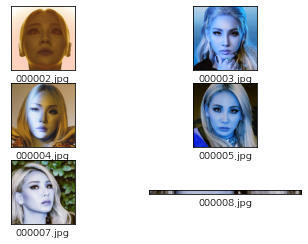

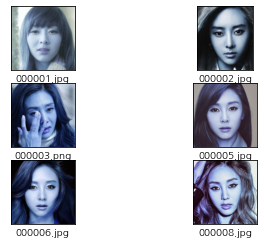

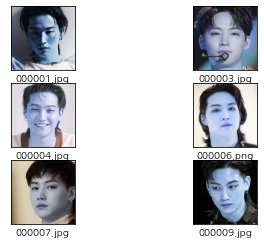

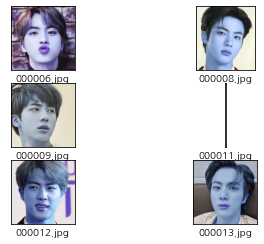

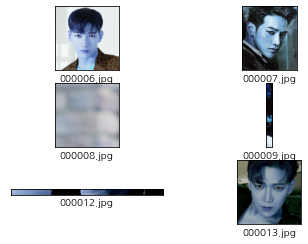

...

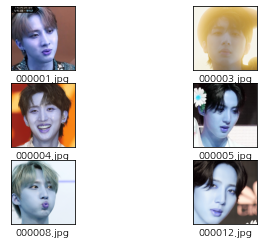

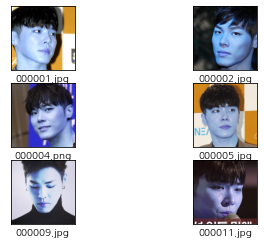

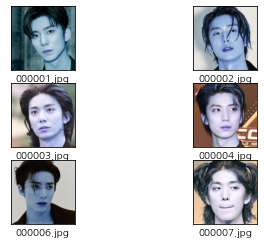

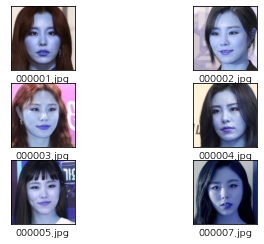

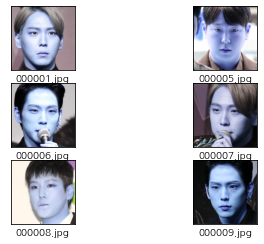

In [9]:
import cv2
from PIL import Image 
import numpy as np
import os
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import re


# cv2에서 한글경로 드가면 못읽어서 읽는 함수
def imread(filename, flags=cv2.IMREAD_COLOR, dtype=np.uint8): 
    try: 
        n = np.fromfile(filename, dtype) 
        img = cv2.imdecode(n, flags) 
        return img 
    except Exception as e: 
        print(e) 
        return None

def imwrite(filename, img, params=None): 
    try: 
        ext = os.path.splitext(filename)[1] 
        result, n = cv2.imencode(ext, img, params) 
        if result: 
            if not os.path.exists(OUTPUT_PATH):
                os.makedirs(OUTPUT_PATH)
            with open(filename, mode='w+b') as f: 
                n.tofile(f)
            return True 
        else: 
            return False 
    except Exception as e: 
        print(e) 
        return False

    
    
FILE_NAME='대한민국_연예인_통합.txt'

f = open(FILE_NAME, 'r',encoding='UTF8')

celebList = []

while True:
    line = f.readline()
    if not line: break
    txt = re.sub(pattern='\(.*\)', repl=' ', string=line)
    txt = txt.replace(' ','')
    txt = txt.replace('\n','')
    #txt = txt.replace('.','')
    #print(txt)
    celebList.append(txt)
f.close()

DOWNLOAD_PATH = "imageDown"

for keyword in tqdm(celebList,desc='얼굴 자르기'):
    
    # 저장된 폴더 이미지 가져오기
    targetDir = DOWNLOAD_PATH+'/'+keyword
    
    if os.path.exists(targetDir):
        files = os.listdir(targetDir)
        OUTPUT_PATH = 'ImageFaceCropped'+'/'+keyword
        # 가중치 파일 경로
        cascade_filename = 'haarcascade_frontalface_alt.xml'
        # 모델 불러오기
        faceCascade = cv2.CascadeClassifier(cascade_filename)
        # 맥픗롯립 보여주기위함
        fig = plt.figure() # rows*cols 행렬의 i번째 subplot 생성
        rows = 3
        cols = 2
        i = 1

        for file in files:

            #print(os.path.abspath(targetDir+'/'+file))
            # 이미지 전처리 (사이즈조절,흑백변환)
            img = imread(targetDir+'/'+file)   
            if np.any(img):
                img = cv2.resize(img,dsize=None,fx=0.5,fy=0.5)
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

                faces = faceCascade.detectMultiScale(gray, 1.3,1,minSize=(20,20))

                if len(faces) ==1:
                    x,y,w,h = faces[0][0],faces[0][1],faces[0][2],faces[0][3]
                    #cv2.rectangle(img, (x,y), (x+w, y+h), (255,0,0),2) #라인 표시
                    cropped = img[y - int(h/4):y + h + int(h/4), x - int(w/4):x + w + int(w/4)]
                    #cv2.rectangle(img, (x,y), (x+w, y+h), (255,0,0),2)
                    if np.any(cropped):
                        imwrite(OUTPUT_PATH+'/'+file, cropped)

                        if i<=(rows*cols):
                            ax = fig.add_subplot(rows, cols, i)
                            ax.imshow(cropped)
                            ax.set_xlabel(file)
                            ax.set_xticks([]), ax.set_yticks([])
                        i+=1


        #     else :
        #         #print("얼굴 미감지")


